In [1]:
import GPy, numpy as np
%matplotlib inline
from matplotlib import pyplot as plt
from IPython.display import HTML
np.random.seed(1234)

In [2]:
from animate_gp import animate_kernel, plot_data, create_empty_ax, fill_grad

In [37]:
from GPy.core.parameterization.param import Param
from paramz.transformations import Logexp

class LnNormBasisFunc(GPy.kern.BasisFuncKernel):
    """
    LogNormal distribution kernel bases.
    
    This kernel adds log normal distributed basis functions as kernel.
    
    You can either define the starting positions for the basis functions, or for each
    extra dimension in `extra_dims` we create one LogNormal base per non-zero entry.
    The base will start at the active_dim corresponding to that entry.
    
    We learn a shape and elongation parameter per base.
    """
    def __init__(
        self, input_dim, 
        shapes=1., elongations=1., variance=1., 
        starts=None, extra_dims=None, 
        active_dims=None, ARD=False, name='ln_norm'
    ):
        assert starts is None or extra_dims is None, "Can either take starts from X, or predefine at init"
        
        if extra_dims is None:
            self._starts = starts
            self.shapes = Param('shapes', shapes*np.ones(starts.size), Logexp())
            self.elongations = Param('elongations', elongations*np.ones(starts.size), Logexp())
            
        super(LnNormBasisFunc, self).__init__(input_dim, variance, active_dims, ARD, name)
        #self.link_parameters(self.shapes, self.elongations)
        
    def _phi(self, X):
        x = X - self._starts[None, :]
        sigma = self.shapes[None, :]
        mu = self.elongations[None, :]
        with np.errstate(invalid='ignore'):
            phi = np.exp(-(np.log(mu * x))**2/(2*sigma)) / (np.sqrt(2 * np.pi * sigma) * mu * x)
            phi[np.isnan(phi)] = 0.0
        return phi

In [38]:
k_f = GPy.kern.Matern32(1)
k_act = LnNormBasisFunc(1, starts=np.array([-1]))

In [39]:
X = np.linspace(-3, 3, 500)[:,None]

K_f = k_f.K(X)
f_se = np.random.multivariate_normal(np.zeros(X.shape[0]), K_f, (1)).T

K_act = k_act.K(X)
f_act = np.random.multivariate_normal(np.zeros(X.shape[0]), K_act, (1)).T

Y = f_se + f_act + np.random.normal(0, .1, f_se.shape)

In [40]:
np.random.seed(1234)

choice = np.random.choice(X.shape[0], 50, replace=False)
choice.sort(0)

_X = X[choice]
_Y = Y[choice]

m = GPy.models.GPRegression(_X, _Y, kernel=k_f + k_act)
m.optimize()

{'dataplot': [<matplotlib.collections.PathCollection at 0x7f76505f29b0>],
 'gpmean': [[<matplotlib.lines.Line2D at 0x7f76505f28d0>]],
 'gpconfidence': [<matplotlib.collections.PolyCollection at 0x7f76505f2e48>]}

 /home/max/miniconda3/envs/kbd/lib/python3.6/site-packages/matplotlib/figure.py:2267: UserWarning:This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


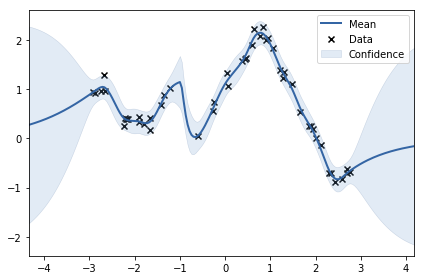

In [41]:
m.plot()

In [42]:
_mu, _K = m.predict_noiseless(X, full_cov=True, kern=m.kern.ln_norm.copy())

fig, ax = create_empty_ax()
ax.set_xlim(X.min(), X.max())
fig.tight_layout()
fill_grad(ax, X, _mu, _K)
#plot_data(ax, _X, _Y)
ax.plot(X, f_act, color='#9e1732', lw=2)
anim = animate_kernel(fig, ax, X, _mu, _K, 'activation_gp_ln_norm.mp4', frames=100)
plt.close(fig)
jshtml = anim.to_jshtml()
HTML(jshtml)

In [45]:
_mu, _K = m.predict_noiseless(X, full_cov=True, kern=m.kern.Mat32.copy())

fig, ax = create_empty_ax()
ax.set_xlim(X.min(), X.max())
fig.tight_layout()
fill_grad(ax, X, _mu, _K)
#plot_data(ax, _X, _Y)
ax.plot(X, f_se, color='#9e1732', lw=2)
anim = animate_kernel(fig, ax, X, _mu, _K, 'activation_gp_mat.mp4', frames=100)
plt.close(fig)
jshtml = anim.to_jshtml()
HTML(jshtml)

In [44]:
_mu, _K = m.predict_noiseless(X, full_cov=True)

fig, ax = create_empty_ax()
ax.set_xlim(X.min(), X.max())
fig.tight_layout()
fill_grad(ax, X, _mu, _K)
plot_data(ax, _X, _Y)
ax.plot(X, f_se+f_act, color='#9e1732', lw=2)
anim = animate_kernel(fig, ax, X, _mu, _K, 'activation_gp_all.mp4', frames=100)
plt.close(fig)
jshtml = anim.to_jshtml()
HTML(jshtml)